In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import os
import sys
import copy
import cv2
import time
import numpy as np
import tabulate
sys.path.append(os.path.join(os.path.abspath(""), ".."))

import matplotlib.pyplot as plt

In [3]:
from app.utils import ImageWrapper
from app.custom import RemoveBusBars, Orient, BusbarMask
from app.transforms import FFT, IFFT, CreateOnesMask, PCA, DownsampleBlur, maskedFFT
from app.filters import *
from app.imager import ImageLoader, DefectViewer, Show, Exposure
from app.transforms import maskedFFT

from app.models import Classifier
from sklearn.linear_model import LogisticRegression

In [4]:
# Seed used in show to show the same images when num_images option is set
seed = 1234

# Utility function for plotting during this EDA:
def plot_10(in_imgs):
    fig, axs = plt.subplots(2,5, figsize=(15, 6))
    fig.subplots_adjust(hspace = .5, wspace=.001)
    axs = axs.ravel()
    for i in range(10):
        axs[i].imshow(in_imgs[i], cmap='Greys_r')
        axs[i].set_title(f'{i}')
        
# Function to make masks
def create_mask(half_width, shape, mtype):
    
  # Create a vertical mask
    if mtype == 'vertical':
        in_mask = np.zeros(shape)
        midpoint = in_mask.shape[1] // 2
        top_left = (midpoint - half_width, 0)
        bottom_right = (midpoint + half_width, shape[0])
        cv2.rectangle(in_mask, top_left, bottom_right, (255, 255, 255), -1)[0]
        in_mask = in_mask / 255
        
  # Create a horizontal mask
    if mtype == 'horizontal':
        in_mask = np.zeros(shape)
        midpoint = in_mask.shape[0] // 2
        top_left = (0, midpoint - half_width)
        bottom_right = (shape[1], midpoint + half_width)
        cv2.rectangle(in_mask, top_left, bottom_right, (255, 255, 255), -1)[0]
        in_mask = in_mask / 255
        
    return in_mask

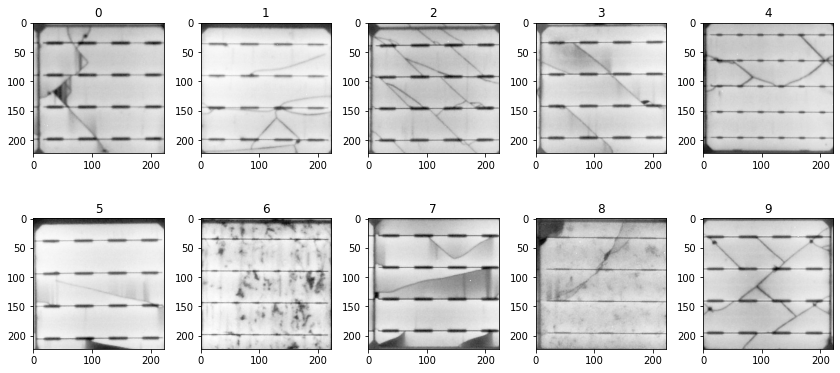

In [5]:
# Load 100 examples and name the category for it. Category is like a title for images
n_samples = 10
closed = (DefectViewer() << (ImageLoader(defect_class='Closed') << n_samples))
closed.category = 'Closed'
all_others = (DefectViewer() << (ImageLoader(defect_class='Closed', is_not=True) << n_samples))
all_others.category = 'all_others'
#_ = Show(num_images=10, seed=seed) << (closed)
plot_10(closed.images)

## EDA

### Description 

Isolated cracks are at their simplest thin dark likes which represent fractures in the cell wafer material. The shape of the crack is determined by the way the crack was created, and also the underlying properties of the wafer. For instance, if the wafer is multicrystalline, the cracks are generally lines which propagate in all directions, and are typically not smooth lines, since there is no underlying crystallographic plane to 'guide' the crack. 

Cracks in monocrystalline wafers are generally 'straighter', smoother lines which tend to propagate along diagonals in the wafer, due to the way that wafers are sliced along the < 1 0 0 > plane. 

Unlike isolated and resistive cracks, these cracks are characterised by the rack line only, and do not cause any isolated dark regions (isolated) or gradients (resistive) which emanate adjacent to the crack line.

Therefore we need to design filters to extract dark thin lines from the image. 

### Potential Approach

- Blur image and apply a filter such as the Sato, Frangi or Meijering filter to extract thin tube/vessel like structures. We also try a Farid edge detector. 
- Threshold our the crack lines 
- Remove any horizontal lines such as busbars which may be present. 

### Vesselness filters

IN the following blocks we apply different vesselness filters with varying sigma's. Due to the different intensities of the output, we stretch the output values to 0-1. 

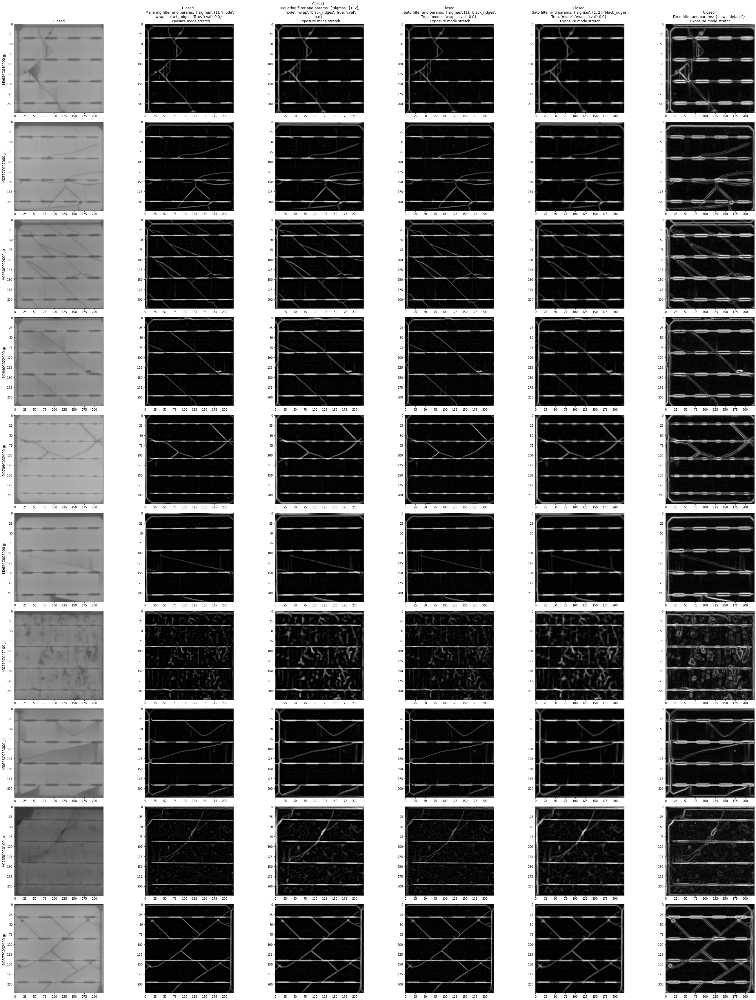

In [7]:
## Test different vesselness filters - sigma = 1,2,3 (note Farid is fixed for comparison)

_, meijering_1 = Exposure('stretch') << (Meijering(sigmas=[1]) <<  closed)
_, sato_1 = Exposure('stretch') <<(Sato(sigmas=[1]) <<  closed)
_, meijering_2 = Exposure('stretch') << (Meijering(sigmas=[1,2]) <<  closed)
_, sato_2 = Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed)
_, farid = Exposure('stretch') << (Farid() <<  closed)
_ = Show(num_images=10, seed=seed) << (closed, meijering_1, meijering_2, sato_1, sato_2, farid)

#### Comments

- The farid filter is highly effetive at detecting the edges, however it is almost picking up too much features and requires further filtering before application.
- The sato and meijiring filters work well filtering the background texture from the cracks, and using sigma of 1 and 2 seems to be superior Using sigma = 1,2 and 3(not shown), and just 1 alone.
- Looking closely, the Sato filter with sigma's 1,2 tends to pick up less background noise than the meijering filter of the same parameters.

We will continue with the Sato filter but first explore the Frangi filter, which allows for a few more parameters to be tuned including:

- alpha: Frangi correction constant that adjusts the filter’s sensitivity to deviation from a plate-like structure. 
- beta: Frangi correction constant that adjusts the filter’s sensitivity to deviation from a blob-like structure.
- gamma: Frangi correction constant that adjusts the filter’s sensitivity to areas of high variance/texture/structure.

[source](https://scikit-image.org/docs/stable/api/skimage.filters.html#skimage.filters.frangi)

For comparison, we also try a Canny filter.

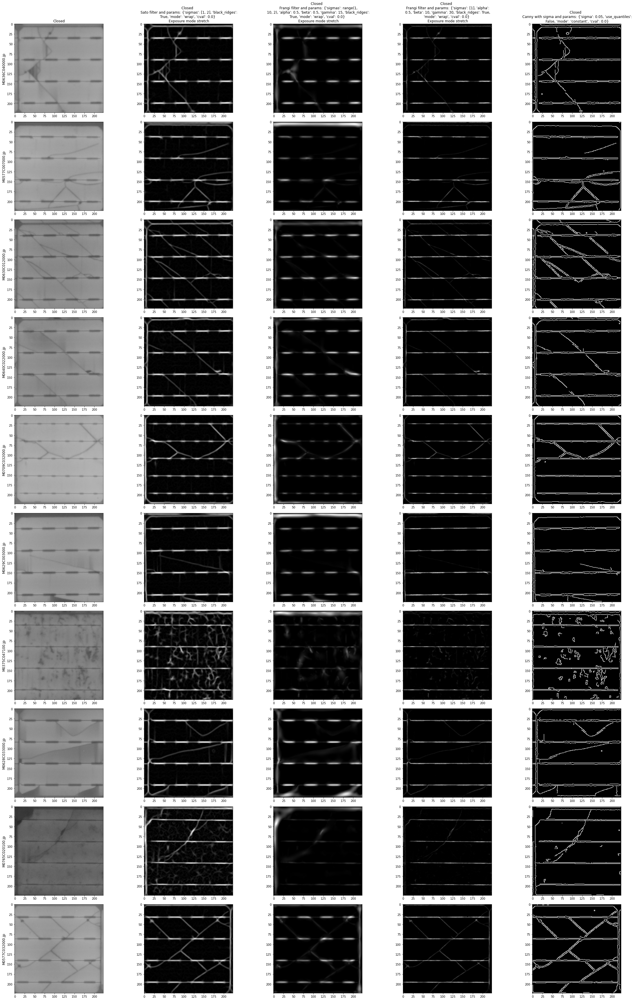

In [8]:
## Test different vesselness filters - sigma = 1,2 

_, sato = Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed)
_, frangi_default = Exposure('stretch') <<(Frangi(sigmas=range(1,10,2)) <<  closed)
_, frangi_1 = Exposure('stretch') <<(Frangi(sigmas=[1], beta=10, gamma=30) <<  closed)
_, canny = (Canny(0.05) <<  closed)
_ = Show(num_images=10, seed=seed) << (closed, sato, frangi_default, frangi_1, canny)

### Evaluation

We find that the sato and meijering filters strike the best balance crack detection, background separation and sensitivity. Despite the additional parameters of the Frangi filter, we were not able to find good parameters which matched the performane of the Sato or Meijering filter. In comparison, the Canny filter required a very small sigma to be sensitive to the thin cracks, however doing so introduced a lot of noise.

### Issues - Horizontal and Vertical Lines

Vertical lines from the cell edges, or front grid interruptions and horizontal lines from the busars are being picked up. In the case of front grid interruptions, the removal of these may help improve performance of distinguishing between these two classes. 

There are two methods which can be trialled:

- FFT filtering the horizontal and vertical magnitudes from the FFT transformed image. 
- Using kernels and morphology functions in OpenCV2. 

#### Fourier Transform

We try a fourier transformed imagge whereby we try the following masks on the transformed magnitude:

- horizontal line - to target vertical frequencies in the image
- vertical line: targets horizontal lines in the image,
- A cross: both vertical and horizontal lines in the image

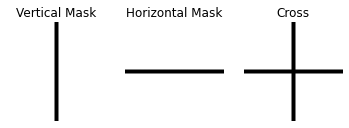

In [9]:
# Make masks
vertical = 1 - create_mask(4, closed.images[0].shape,'vertical')
horizontal = 1 - create_mask(4, closed.images[0].shape,'horizontal')
cross = vertical + horizontal - 1
cross[cross < 1] = 0

# Plot
_, axes = plt.subplots(nrows=1, ncols=3)
axes[0].imshow(vertical, cmap='gray')
axes[0].set_axis_off()
axes[0].set_title('Vertical Mask')
axes[1].imshow(horizontal, cmap='gray')
axes[1].set_axis_off()
_ = axes[1].set_title('Horizontal Mask')
axes[2].imshow(cross, cmap='gray')
axes[2].set_axis_off()
_ = axes[2].set_title('Cross')

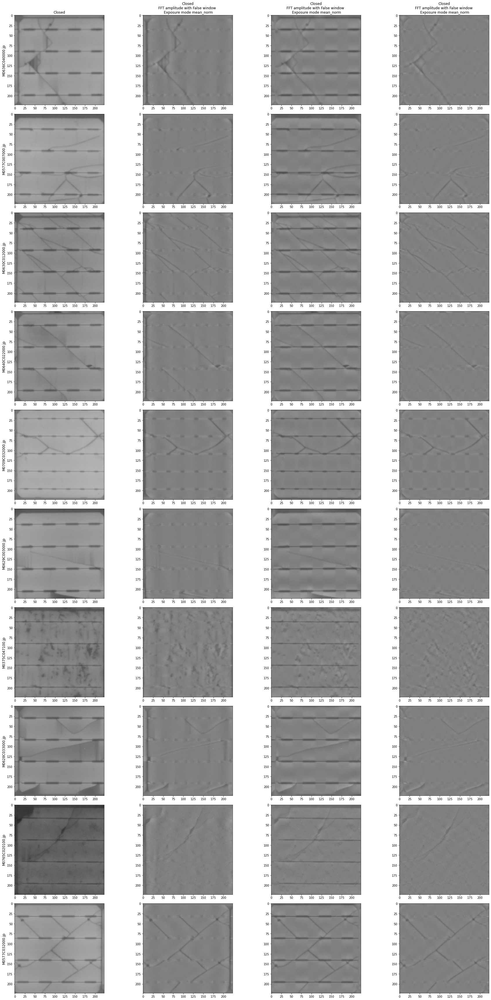

In [10]:
_, vertical_ = (Exposure('mean_norm') << (maskedFFT(mask=vertical, window=False) << closed))
_, horizontal_ = (Exposure('mean_norm') <<(maskedFFT(mask=horizontal, window=False) << closed))
_, cross_ = (Exposure('mean_norm') << (maskedFFT(mask=cross, window=False) << closed))
_ = Show(num_images=10, seed=seed) << (closed, vertical_, horizontal_, cross_)

The series of filters applied to the fourier magnitude have done a reasonable job of removing horizontal and vertical lines from the images. 

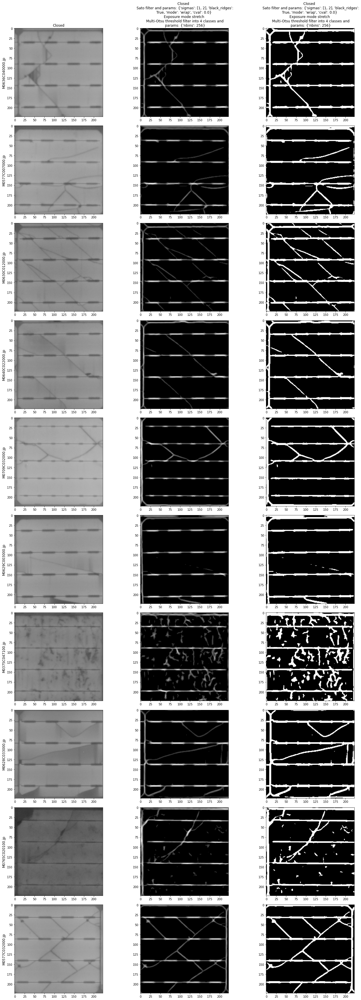

In [11]:
_, Thresholded_1 = ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) << (Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed))
_, Thresholded_2 = ThresholdMultiotsu(n_classes=4, threshold=2) << (Exposure('stretch') <<(Sato(sigmas=[1,2]) <<  closed))

_ = Show(num_images=10, seed=seed) << (closed, Thresholded_1, Thresholded_2)

## Putting it all together

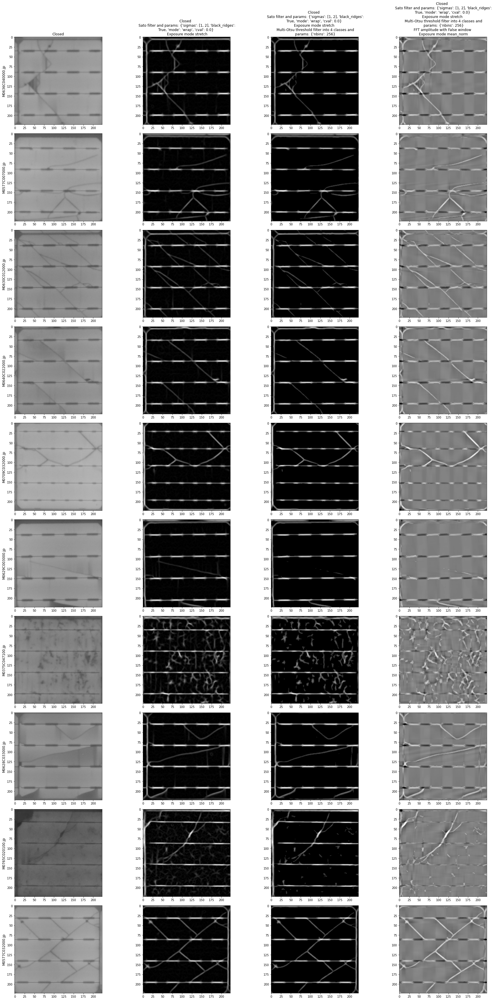

In [12]:
vertical = 1 - create_mask(3, closed.images[0].shape,'vertical')
horizontal = 1 - create_mask(3, closed.images[0].shape,'horizontal')
cross = vertical + horizontal - 1
cross[cross < 1] = 0

_, sato_stretched =  (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed))
_, sato_thresholded = (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False)) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed))
_, sato_thresholded_fft = (Exposure('mean_norm') << (maskedFFT(mask=cross, window=False) \
                                << (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed)))))



_ = Show(num_images=10, seed=seed) << (closed, sato_stretched, sato_thresholded, sato_thresholded_fft)

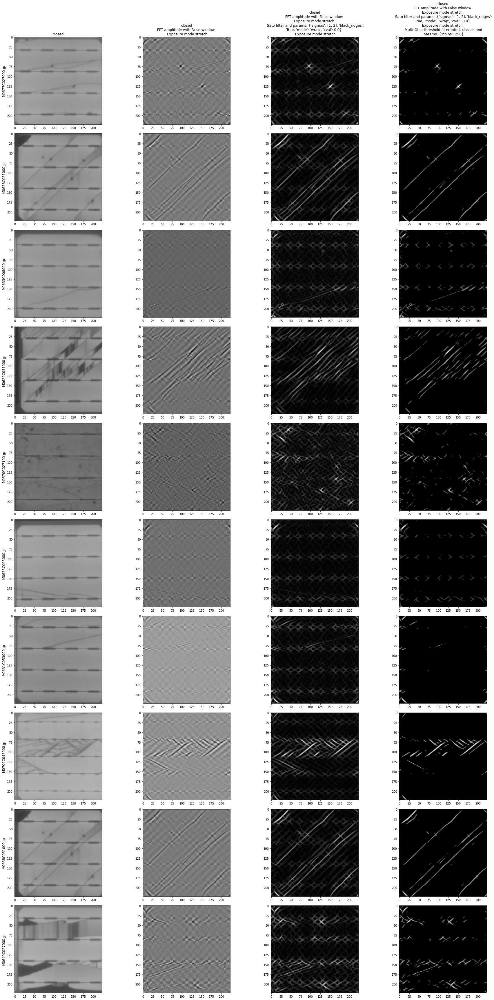

In [138]:
vertical = 1 - create_mask(10, closed.images[0].shape,'vertical')
horizontal = 1 - create_mask(10, closed.images[0].shape,'horizontal')
cross = vertical + horizontal - 1
cross[cross < 1] = 0

maskedfft = (Exposure('stretch') << (maskedFFT(mask=cross, window=False) << closed))
sato_maskedfft = Exposure('stretch') << (Sato(sigmas=[1,2]) << maskedfft)
thresholded_sato_maskedfft = (ThresholdMultiotsu(n_classes=4, threshold=2, digitize=False) << sato_maskedfft)

_ = Show(num_images=10, seed=seed) << (closed, maskedfft[1], sato_maskedfft[1], thresholded_sato_maskedfft[1])

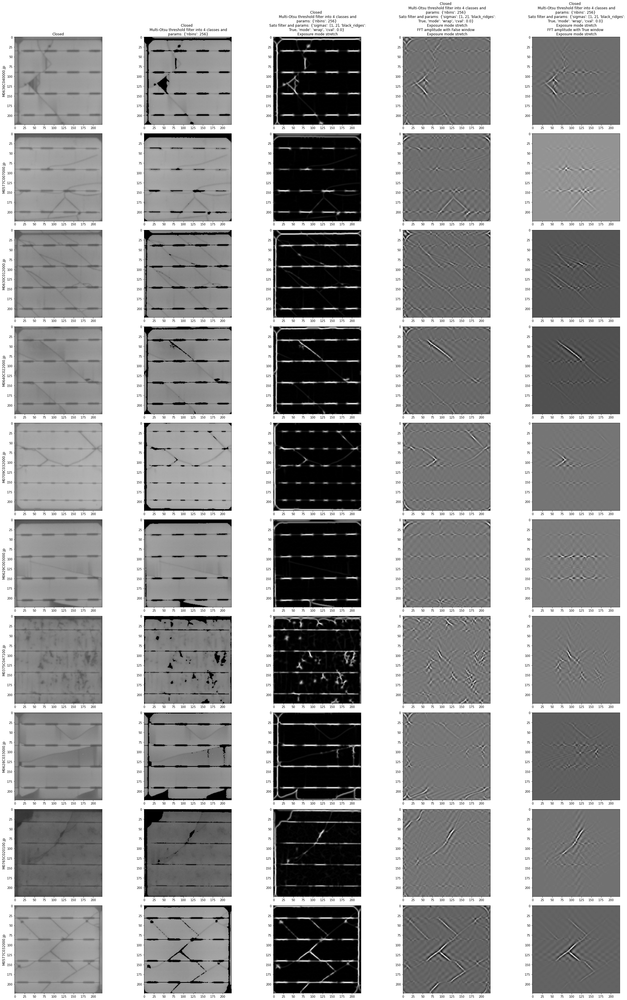

In [14]:
# Create masak
vertical = 1 - create_mask(10, closed.images[0].shape,'vertical')
horizontal = 1 - create_mask(10, closed.images[0].shape,'horizontal')
cross = vertical + horizontal - 1
cross[cross < 1] = 0

# Apply threshold
thresholded = (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) << closed)
# Apply sato filter and stretch exposure
sato_thresholded = Exposure('stretch') << (Sato(sigmas=[1,2]) << thresholded)
# Apply cross mask top the inverse FFT 
maskedfft_sato_thresholded = (Exposure('stretch') << (maskedFFT(mask=cross, window=False) << sato_thresholded))
maskedfft_sato_thresholded_window = (Exposure('stretch') << (maskedFFT(mask=cross, window=True) << sato_thresholded))

_ = Show(num_images=10, seed=seed) << (closed, thresholded[1],  sato_thresholded[1], maskedfft_sato_thresholded[1], maskedfft_sato_thresholded_window[1])

### Dimensionality Reduction and EDA

To get a general idea of how well we can classify the data, we now implement dimensionality reduction on the classes.

(1000, 223, 223)


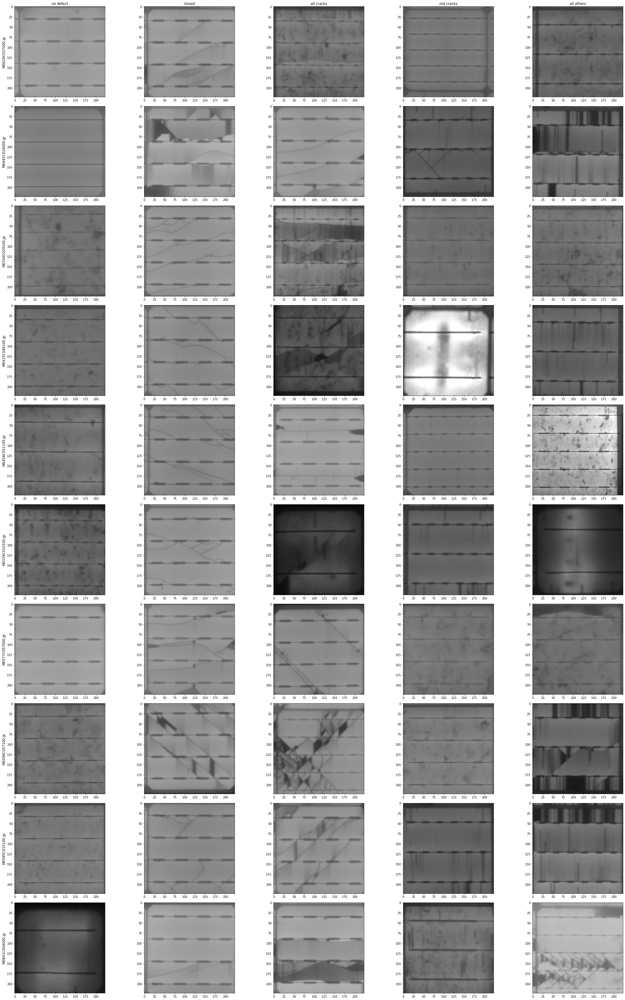

In [111]:
###
n_samples = 200

# Closed cracks
closed = (DefectViewer() << (ImageLoader(defect_class='Closed') << n_samples))
closed.category = 'closed'

# Clean - no defects at all 
clean = (DefectViewer() << (ImageLoader(defect_class='None') << n_samples))
clean.category = 'no defect'

# Every class except the 'closed'
all_others = (DefectViewer() << (ImageLoader(defect_class='Closed', is_not=True) << n_samples))
all_others.category = 'all others'

# All cracks 
all_cracks = (DefectViewer() << (ImageLoader(defect_class=['Closed', 'Resistive', 'Isolated']) << n_samples))
all_cracks.category = 'all cracks'

# All classes without any cracks at all
not_cracks = (DefectViewer() << (ImageLoader(defect_class=['Closed', 'Resistive', 'Isolated'], is_not=True) << n_samples))
not_cracks.category = 'not cracks'

# Make one big array with all images stacked.
obj_lists = [clean, closed, all_others, all_cracks, not_cracks]
labels = []

# process labels. 
for obj in obj_lists:
    [labels.append(obj.category) for x in range(n_samples)]

# process images
img_list = []
[img_list.append(obj.images) for obj in obj_lists]

img_matrix = np.vstack(img_list)
print(img_matrix.shape)

# NOte all others includes isolated and resistive
_ = Show(num_images=10, seed=seed) << (clean, closed, all_cracks, not_cracks, all_others)

In [112]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA as sk_PCA
from sklearn.manifold import TSNE
from matplotlib.lines import Line2D

# Stack all images
img_matrix_ = img_matrix.reshape(img_matrix.shape[0], img_matrix.shape[1] * img_matrix.shape[2])

# Perform PCA
PCA_ = sk_PCA(n_components = 2, whiten=True)
scaler = StandardScaler()
scaler.fit(img_matrix_)

zero_meaned_matrix = scaler.transform(img_matrix_)
reduced_values = PCA_.fit_transform(zero_meaned_matrix)

#Perform TSNE
tsne_reduced = TSNE(n_components=2, perplexity=20).fit_transform(zero_meaned_matrix)

# Plot 
colors = {'closed':'tab:blue', 'no defect':'tab:orange', 'all others':'tab:green', 'all cracks':'tab:red', 'not cracks':'tab:purple'}

We need to be careful when comparing against the 'all others' defects - since there are example images where defects have been mislabelled or missed. We can see even in the example above, there are cases where 'closed' cracks exist in the 'all_others' category.

The authors of the original dataset lumped all crack classes together for this reason.

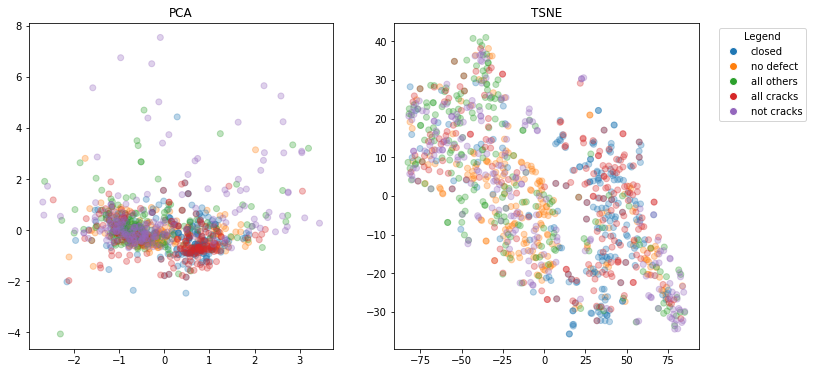

In [113]:
# PLot using PCA
#https://stackoverflow.com/questions/26139423/plot-different-color-for-different-categorical-levels-using-matplotlib
from matplotlib.lines import Line2D
fig, axs = plt.subplots(nrows=1,ncols=2, figsize=(12, 6))
axs[0].scatter(reduced_values[:,0], reduced_values[:,1], c=my_df['label'].map(colors), alpha=0.3)
axs[0].set_title('PCA')

axs[1].scatter(tsne_reduced[:,0], tsne_reduced[:,1], c=my_df['label'].map(colors), alpha=0.3)
# add a legend
handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=v, label=k, markersize=8) for k, v in colors.items()]
axs[1].legend(title='Legend', handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')
axs[1].set_title('TSNE')
plt.show()


#### Transforms:

Transforms 1: 

- Threshold with Multiotsu filter
- Apply sato filter and stretch exposure.
- Apply mask to the fft and stretch exposure. 

1. Apply threshold
thresholded = (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) << closed)
2. Apply sato filter and stretch exposure
sato_thresholded = Exposure('stretch') << (Sato(sigmas=[1,2]) << thresholded)
3. Apply cross mask top the inverse FFT 
maskedfft_sato_thresholded = (Exposure('stretch') << (maskedFFT(mask=cross, window=False) << sato_thresholded))
maskedfft_sato_thresholded_window = (Exposure('stretch') << (maskedFFT(mask=cross, window=True) << sato_thresholded))

In [114]:
def t1(obj): 
    t1 = (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) << obj)
    # Apply sato filter and stretch exposure
    t2= Exposure('stretch') << (Sato(sigmas=[1,2]) << t1)
    # Apply cross mask top the inverse FFT 
    out_obj = (Exposure('stretch') << (maskedFFT(mask=cross, window=False) << t2))
    return out_obj
   

In [115]:
closed_t1 = t1(closed)
clean_t1 = t1(clean)
all_others_t1 = t1(all_others)
all_cracks_t1 = t1(all_cracks)
not_cracks_t1 = t1(not_cracks)

t1_obj_list = [closed_t1[1], clean_t1[1], all_others_t1[1], all_cracks_t1[1], not_cracks_t1[1]]

In [116]:
# process images
img_list = []
[img_list.append(obj.images) for obj in t1_obj_list]

img_matrix = np.vstack(img_list)
print(img_matrix.shape)

# NOte all others includes isolated and resistive
#_ = Show(num_images=10, seed=seed) << (clean, closed, all_cracks, not_cracks, all_others)

(1000, 223, 223)


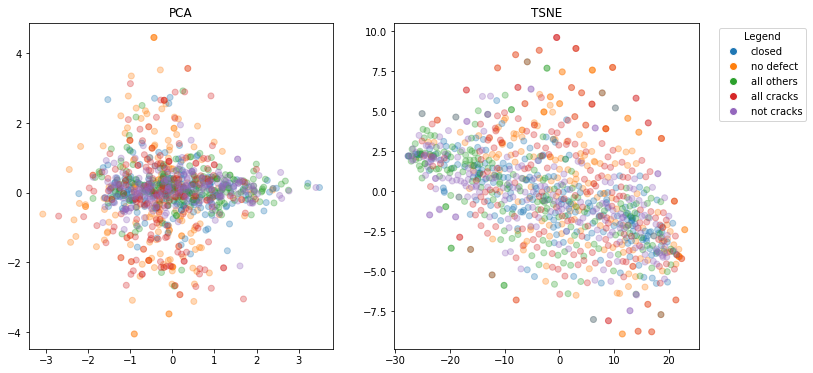

In [121]:
# Stack all images
img_matrix_ = img_matrix.reshape(img_matrix.shape[0], img_matrix.shape[1] * img_matrix.shape[2])

# Perform PCA
PCA_ = sk_PCA(n_components = 2, whiten=True)
scaler = StandardScaler()
scaler.fit(img_matrix_)

zero_meaned_matrix = scaler.transform(img_matrix_)
reduced_values = PCA_.fit_transform(zero_meaned_matrix)

#Perform TSNE
tsne_reduced = TSNE(n_components=2, perplexity=50).fit_transform(img_matrix_)

# PLot using PCA
#https://stackoverflow.com/questions/26139423/plot-different-color-for-different-categorical-levels-using-matplotlib
from matplotlib.lines import Line2D
fig, axs = plt.subplots(nrows=1,ncols=2, figsize=(12, 6))
axs[0].scatter(reduced_values[:,0], reduced_values[:,1], c=my_df['label'].map(colors), alpha=0.3)
axs[0].set_title('PCA')

axs[1].scatter(tsne_reduced[:,0], tsne_reduced[:,1], c=my_df['label'].map(colors), alpha=0.3)
# add a legend
handles = [Line2D([0], [0], marker='o', color='w', markerfacecolor=v, label=k, markersize=8) for k, v in colors.items()]
axs[1].legend(title='Legend', handles=handles, bbox_to_anchor=(1.05, 1), loc='upper left')
axs[1].set_title('TSNE')
plt.show()


In [122]:
### Classifier

In [123]:
###
n_samples = 500

# Closed cracks
closed = (DefectViewer() << (ImageLoader(defect_class='Closed') << n_samples))
closed.category = 'closed'

# Clean - no defects at all 
clean = (DefectViewer() << (ImageLoader(defect_class='None') << n_samples))
clean.category = 'no defect'

# Every class except the 'closed'
all_others = (DefectViewer() << (ImageLoader(defect_class='Closed', is_not=True) << n_samples))
all_others.category = 'all others'

# All cracks 
all_cracks = (DefectViewer() << (ImageLoader(defect_class=['Closed', 'Resistive', 'Isolated']) << n_samples))
all_cracks.category = 'all cracks'

# All classes without any cracks at all
not_cracks = (DefectViewer() << (ImageLoader(defect_class=['Closed', 'Resistive', 'Isolated'], is_not=True) << n_samples))
not_cracks.category = 'not cracks'


In [151]:
scores = []
titles = []

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200}
cla = Classifier(closed, clean, LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. clean')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

thresholded_closed = (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) << closed)
thresholded_clean = (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) << clean)

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200}
cla = Classifier(thresholded_closed[1], thresholded_clean[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. clean + Thresholding')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

sato_thresh_closed = Exposure('stretch') << (Sato(sigmas=[1,2]) << thresholded_closed)
sato_thresh_clean = Exposure('stretch') << (Sato(sigmas=[1,2]) << thresholded_clean)

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200, 'max_iter':100}
cla = Classifier(sato_thresh_closed[1], sato_thresh_clean[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. clean + Thresholding + Sato')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))
fft_sato_thresh_closed = (Exposure('stretch') << (maskedFFT(mask=cross, window=False) << sato_thresh_closed))
fft_sato_thresh_clean = (Exposure('stretch') << (maskedFFT(mask=cross, window=False) << sato_thresh_clean))

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200, 'max_iter':100}
cla = Classifier(fft_sato_thresh_closed[1], fft_sato_thresh_clean[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. clean + Thresholding + Sato + fft')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.8103835169318645
          Pred 0    Pred 1
------  --------  --------
True 0        73        13
True 1        26        88


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.788453692370461
          Pred 0    Pred 1
------  --------  --------
True 0        73        13
True 1        31        83


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.8148714810281518
          Pred 0    Pred 1
------  --------  --------
True 0        70        16
True 1        21        93
0.6805385556915544
          Pred 0    Pred 1
------  --------  --------
True 0        65        21
True 1        45        69


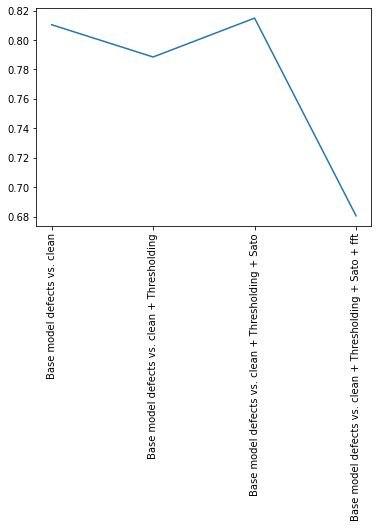

In [152]:
import matplotlib.pyplot as plt
import numpy as np

x = np.arange(len(scores))
y = np.array(scores)
plt.xticks(x, titles, rotation=90)
plt.plot(x, y, '-')
plt.show()

/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7930436556507547
          Pred 0    Pred 1
------  --------  --------
True 0        67        19
True 1        22        92


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.8236434108527132
          Pred 0    Pred 1
------  --------  --------
True 0        70        16
True 1        19        95


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.8352713178294574
          Pred 0    Pred 1
------  --------  --------
True 0        72        14
True 1        19        95
0.7315381476948184
          Pred 0    Pred 1
------  --------  --------
True 0        70        16
True 1        40        74


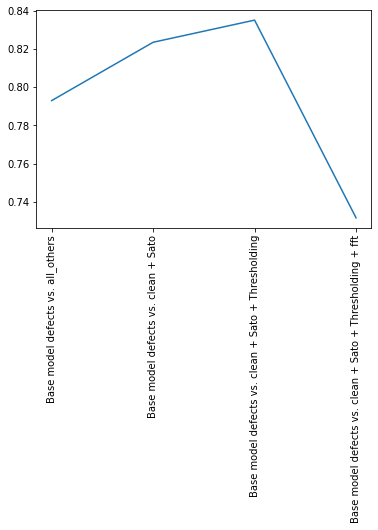

In [150]:
scores = []
titles = []

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200}
cla = Classifier(closed, all_others, LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

#Pipelne for closed
sato_closed =  (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed))
thresh_sato_closed = (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False)) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed))
fft_thresh_sato_closed = (Exposure('mean_norm') << (maskedFFT(mask=cross, window=False) \
                                << (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed)))))

#Pipeline for None
sato_clean =  (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  clean))
thresh_sato_clean = (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False)) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  clean))
fft_thresh_sato_clean = (Exposure('mean_norm') << (maskedFFT(mask=cross, window=False) \
                                << (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  clean)))))

scores.append(score)
titles.append('Base model defects vs. all_others')

conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200}
cla = Classifier(sato_closed[1], sato_clean[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. clean + Sato')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200, 'max_iter':100}
cla = Classifier(sato_thresh_closed[1], sato_thresh_clean[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. clean + Sato + Thresholding')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200, 'max_iter':100}
cla = Classifier(fft_sato_thresh_closed[1], fft_sato_thresh_clean[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. clean + Sato + Thresholding + fft')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

x = np.arange(len(scores))
y = np.array(scores)
plt.xticks(x, titles, rotation=90)
plt.plot(x, y, '-')
plt.show()

/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.8017135862913096
          Pred 0    Pred 1
------  --------  --------
True 0        70        16
True 1        24        90


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.797327621379029
          Pred 0    Pred 1
------  --------  --------
True 0        70        16
True 1        25        89


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7740718074255406
          Pred 0    Pred 1
------  --------  --------
True 0        66        20
True 1        25        89
0.6544267645858833
          Pred 0    Pred 1
------  --------  --------
True 0        59        27
True 1        43        71


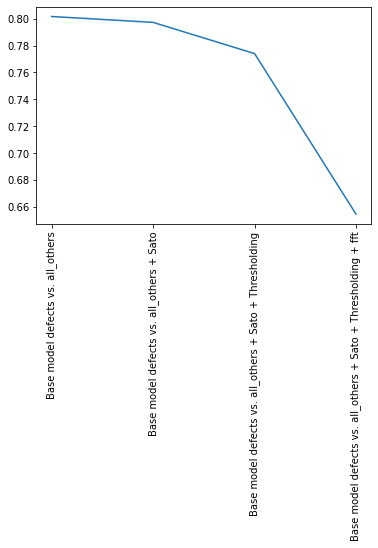

In [149]:
scores = []
titles = []

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims':200}
cla = Classifier(closed, all_others, LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

#Pipelne for closed
#Pipeline for None
sato_all_others =  (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  all_others))
thresh_sato_all_othersn = (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False)) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  all_others))
fft_thresh_sato_all_others = (Exposure('mean_norm') << (maskedFFT(mask=cross, window=False) \
                                << (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  all_others)))))

scores.append(score)
titles.append('Base model defects vs. all_others')

conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200}
cla = Classifier(sato_closed[1], sato_all_others[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. all_others + Sato')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200, 'max_iter':100}
cla = Classifier(sato_thresh_closed[1], sato_thresh_all_others[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. all_others + Sato + Thresholding')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200, 'max_iter':100}
cla = Classifier(fft_sato_thresh_closed[1], fft_sato_thresh_all_others[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. all_others + Sato + Thresholding + fft')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

x = np.arange(len(scores))
y = np.array(scores)
plt.xticks(x, titles, rotation=90)
plt.plot(x, y, '-')
plt.show()

/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.797327621379029
          Pred 0    Pred 1
------  --------  --------
True 0        70        16
True 1        25        89


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.6893104855161158
          Pred 0    Pred 1
------  --------  --------
True 0        65        21
True 1        43        71
0.7986536107711137
          Pred 0    Pred 1
------  --------  --------
True 0        74        12
True 1        30        84
0.7840677274581803
          Pred 0    Pred 1
------  --------  --------
True 0        73        13
True 1        32        82


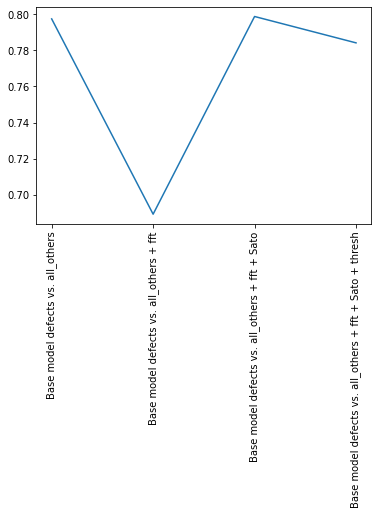

In [154]:
### Final Variation

fft_closed = (Exposure('stretch') << (maskedFFT(mask=cross, window=False) << closed))
sato_fft_closed = Exposure('stretch') << (Sato(sigmas=[1,2]) << fft_closed)
thresh_sato_fft_closed = (ThresholdMultiotsu(n_classes=4, threshold=2, digitize=False) << sato_fft_closed)

fft_clean = (Exposure('stretch') << (maskedFFT(mask=cross, window=False) << clean))
sato_fft_clean = Exposure('stretch') << (Sato(sigmas=[1,2]) << fft_clean)
thresh_sato_fft_clean = (ThresholdMultiotsu(n_classes=4, threshold=2, digitize=False) << sato_fft_clean)

fft_all_others = (Exposure('stretch') << (maskedFFT(mask=cross, window=False) << all_others))
sato_fft_all_others = Exposure('stretch') << (Sato(sigmas=[1,2]) << fft_all_others)
thresh_sato_fft_all_others = (ThresholdMultiotsu(n_classes=4, threshold=2, digitize=False) << sato_fft_all_others)


scores = []
titles = []

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims':200}
cla = Classifier(closed, all_others, LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. all_others')

conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200}
cla = Classifier(fft_closed[1], fft_all_others[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. all_others + fft')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200, 'max_iter':100}
cla = Classifier(sato_fft_closed[1], sato_fft_all_others[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. all_others + fft + Sato')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200, 'max_iter':100}
cla = Classifier(thresh_sato_fft_closed[1], thresh_sato_fft_all_others[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. all_others + fft + Sato + thresh')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

x = np.arange(len(scores))
y = np.array(scores)
plt.xticks(x, titles, rotation=90)
plt.plot(x, y, '-')
plt.show()


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.8279273765809874
          Pred 0    Pred 1
------  --------  --------
True 0        73        13
True 1        22        92


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7199102407180742
          Pred 0    Pred 1
------  --------  --------
True 0        68        18
True 1        40        74
0.8147694818441452
          Pred 0    Pred 1
------  --------  --------
True 0        73        13
True 1        25        89
0.8075275397796817
          Pred 0    Pred 1
------  --------  --------
True 0        71        15
True 1        24        90


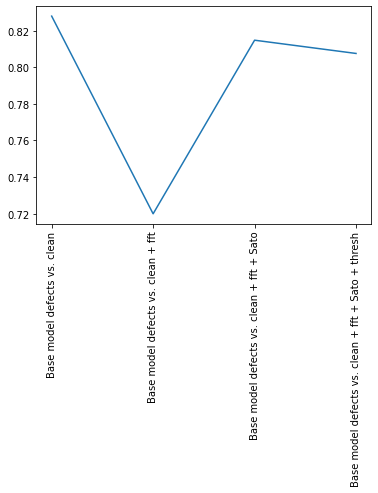

In [156]:
### Final Variation
scores = []
titles = []

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims':200}
cla = Classifier(closed, clean, LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. clean')

conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200}
cla = Classifier(fft_closed[1], fft_clean[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. clean + fft')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200, 'max_iter':100}
cla = Classifier(sato_fft_closed[1], sato_fft_clean[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. clean + fft + Sato')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

# Base model on raw data - single defect vs. clean
model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200, 'max_iter':100}
cla = Classifier(thresh_sato_fft_closed[1], thresh_sato_fft_clean[1], LogisticRegression, None)
score = cla.fit(**model_params)
print(score)

scores.append(score)
titles.append('Base model defects vs. clean + fft + Sato + thresh')

# Misclassified
conf, out = cla.misclassified()
print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))

x = np.arange(len(scores))
y = np.array(scores)
plt.xticks(x, titles, rotation=90)
plt.plot(x, y, '-')
plt.show()


In [157]:
### Optimiser

In [184]:
scores = []
titles = []

#Pipelne for closed
sato_closed =  (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed))
thresh_sato_closed = (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False)) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed))
fft_thresh_sato_closed = (Exposure('mean_norm') << (maskedFFT(mask=cross, window=False) \
                                << (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  closed)))))

#Pipeline for None
sato_clean =  (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  clean))
thresh_sato_clean = (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False)) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  clean))
fft_thresh_sato_clean = (Exposure('mean_norm') << (maskedFFT(mask=cross, window=False) \
                                << (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  clean)))))

#Pipeline for all others
sato_all_others =  (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  all_others))
thresh_sato_all_others = (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False)) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  all_others))
fft_thresh_sato_all_others = (Exposure('mean_norm') << (maskedFFT(mask=cross, window=False) \
                                << (ThresholdMultiotsu(n_classes=4, threshold=1, digitize=False) \
                                << (Exposure('stretch') << (Sato(sigmas=[1,2]) <<  all_others)))))


In [179]:
scores_clean = []
scores_others = []
titles_clean = []
titles_others = []

In [194]:
# Base model on raw data - single defect vs. clean

closed_transformed = [sato_closed[1], thresh_sato_closed[1], fft_thresh_sato_closed[1]]
clean_transformed = [sato_clean[1], thresh_sato_clean[1], fft_thresh_sato_clean[1]]
all_others_transformed = [sato_all_others[1], thresh_sato_all_others[1], fft_thresh_sato_all_others[1]]
titles = ['',' + Sato', ' + Sato + Thresholding', ' + Sato + Thresholding + fft']
comp='clean'

def run_classifier(base, comparison, model, comparison_, title, scores, titles):
    for i in range(len(base)):

        model_params = {'penalty': 'l2', 'seed': 4156, 'pca_dims': 200, 'max_iter':200}
        cla = Classifier(base[i], comparison[i], model, None)
        score = cla.fit(**model_params)
        print(score)
        scores.append(score)
        titles.append(f'Base Model Defects vs. {comparison_}{title[i]}')
        conf, out = cla.misclassified()
        print(tabulate.tabulate([['True 0', conf[0, 0], conf[0, 1]], ['True 1', conf[1, 0], conf[1, 1]]], headers=['', 'Pred 0', 'Pred 1']))


In [195]:
run_classifier(closed_transformed, clean_transformed, comparison_='clean', 
               title=titles, model=LogisticRegression, scores=scores_clean, titles=titles_clean)

0.986842105263158
          Pred 0    Pred 1
------  --------  --------
True 0        86         0
True 1         3       111
0.986842105263158
          Pred 0    Pred 1
------  --------  --------
True 0        86         0
True 1         3       111
0.596389228886169
          Pred 0    Pred 1
------  --------  --------
True 0        46        40
True 1        39        75


In [196]:
run_classifier(closed_transformed, all_others_transformed, comparison_='all_others', 
               title=titles, model=LogisticRegression, scores=scores_others, titles=titles_others)

/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7871277029783761
          Pred 0    Pred 1
------  --------  --------
True 0        69        17
True 1        26        88


/opt/conda/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


0.7900856793145654
          Pred 0    Pred 1
------  --------  --------
True 0        68        18
True 1        24        90
0.6103631170950632
          Pred 0    Pred 1
------  --------  --------
True 0        65        21
True 1        61        53


In [200]:
from sklearn import svm
run_classifier(closed_transformed, all_others_transformed, comparison_='all_others', 
               title=titles, model=Kmeans, scores=scores_others, titles=titles_others)

NameError: name 'Kmeans' is not defined